In [19]:
%load_ext autoreload
%autoreload 2

In [2]:
%cd ..

/Users/gimli/projects/igre


In [18]:
import numpy as np
import tensorflow as tf
import os
import imageio

In [21]:
LEONARDO_MADONNA_WITH_YARNWINDER = "tests/assets/leonardo.npy"

In [37]:
import sys
import numpy as np
import tensorflow as tf
from time import time
from src.tftools.callbacks.inter_predict import InterPredictCallback


def __train_networks(inputs, outputs, layers, training_set_size, log=print, callbacks=[]):
    """
    Train several networks and return the best one. Usage:

        bestNetwork, history = trainNetworks(indexes, inputs, outputs, annCount,
                layers, trainingSetSize, useGPU)

    Mandatory arguments:
        indexes = array of indexes to the input image
        inputs = input image (must be 3D, even if the third dimension is trivial)
        outputs = output vectors
        layers = numbers of neurons in inner layers of ANN
        trainingSetSize = number of inputs/outputs used for training (randomly
            selected)

    Function uses trainscg for training ANN and number of epochs is set to 10k.
    """

    # randomly select 'trainingSetSize' data samples
    log(f"Selecting {training_set_size} samples randomly for use by algorithm.")
    perm = np.random.permutation(inputs.shape[0])
    ins = inputs[perm[:training_set_size], :]
    outs = outputs[perm[:training_set_size], :]

    # define model
    log(f"Adding input layer, width = {inputs.shape[1]}")
    input_layer = tf.keras.layers.Input(shape=(inputs.shape[1],),
                                        dtype=tf.float32, name='InputLayer')
    layer = input_layer
    if layers is None:
        layers = [25, 25]
    for layer_idx in range(len(layers)):
        log(f"Adding dense layer, width = {layers[layer_idx]}")
        layer = tf.keras.layers.Dense(layers[layer_idx],
                                      activation='sigmoid', name='Dense' + str(layer_idx))(layer)
    log(f"Adding dense layer, width = {outputs.shape[1]}")
    output_layer = tf.keras.layers.Dense(outputs.shape[1], activation='sigmoid', name='Output')(layer)

    model = tf.keras.models.Model(inputs=input_layer, outputs=output_layer)

    start_time = time()
    model.compile(optimizer='adam',
                  loss='mean_squared_error',
                  metrics=['mean_squared_error']
                  )
    elapsed_time = time() - start_time
    log(f"Compiling model took {elapsed_time:.4f}'s.")

    # train model
    start_time = time()
    history = model.fit(ins,
                        outs,
                        epochs=100,
                        validation_split=0.2,
                        verbose=1,
                        callbacks=callbacks
                        )

    elapsed_time = time() - start_time
    num_epochs = len(history.history['loss'])

    log(f"{(elapsed_time / num_epochs):.4f}'s time per epoch. Epochs: {num_epochs}")
    log(f"Total time {elapsed_time:.4f}'s")

    # calculate gain and print it out
    gain = abs(outputs - model.predict(inputs)) / (outputs.shape[0] * outputs.shape[1])
    log(f"Gain: {gain.flatten().max():1.4e}")

    return model, history


def information_gain(visible,
                     target,
                     layers=None,
                     training_set_size: int = 25000,
                     log=print):
    """
    Compute information gain of the target for visible. Usage:

        infGain, extrapolation, model = informationGain(visible, target, ...)

    Transform function for transformation of visible to target will be trained by
    FF-ANN. By this neural network extrapolation is computed.  Finally, information
    gain is computed as difference between target and extrapolation.  'visible' and
    'target' must have same dimensions (width, height).

    Mandatory arguments:
        visible = 3-dimensional array of VIS pixel intensities in form (height,
            width, modalities)
        target  = 3-dimensional array of NIR pixel intensities in form (height,
            width, modalities)

    Optional parameters:
        layers = array of layer widths
        training_set_size = number of samples used for training, if 'None' is passed,
            all pixels will be used (for training, evaluation, and testing)

    Example:
        informationGain(visible, target layers=[10, 10],
                trainingSetSize=3000)
    """

    if visible.shape[0] != target.shape[0] or visible.shape[1] != target.shape[1]:
        sys.exit("Error: dimension mismatch between 'target' and 'visible'")

    if len(target.shape) == 2:
        target = target.reshape((target.shape[0], target.shape[1], 1))

    if training_set_size is None:
        # use the whole image for training, evaluation and test
        training_set_size = visible.shape[0] * visible.shape[1]

    inputs = visible.reshape((visible.shape[0] * visible.shape[1], visible.shape[2]))
    outputs = target.reshape((target.shape[0] * target.shape[1], target.shape[2]))

    callbacks = [
        tf.keras.callbacks.EarlyStopping(patience=6, min_delta=10 ** -5),
        InterPredictCallback(1, f"data/ig-animations/{time()}", inputs, target.shape)
    ]
    
    # train ANN
    model, history = __train_networks(inputs, outputs, layers, training_set_size, log=log, callbacks=callbacks)

    extrapolation = model.predict(inputs)
    extrapolation = extrapolation.reshape(target.shape)

    inf_gain = target - extrapolation

    return inf_gain, extrapolation, model


In [44]:
tf.random.set_random_seed(12345)
data = np.load(LEONARDO_MADONNA_WITH_YARNWINDER)
[diff, target, _] = information_gain(data[:400, :400, :16], data[:400, :400, 20], training_set_size=1000)

Selecting 1000 samples randomly for use by algorithm.
Adding input layer, width = 16
Adding dense layer, width = 25
Adding dense layer, width = 25
Adding dense layer, width = 1
Compiling model took 0.0351's.
Train on 800 samples, validate on 200 samples
Epoch 1/100
800/800 [==============================] - 4s 5ms/sample - loss: 0.1451 - mean_squared_error: 0.1451 - val_loss: 0.0927 - val_mean_squared_error: 0.0927
Epoch 2/100
800/800 [==============================] - 5s 6ms/sample - loss: 0.0538 - mean_squared_error: 0.0538 - val_loss: 0.0343 - val_mean_squared_error: 0.0343
Epoch 3/100
800/800 [==============================] - 4s 5ms/sample - loss: 0.0238 - mean_squared_error: 0.0238 - val_loss: 0.0212 - val_mean_squared_error: 0.0212
Epoch 4/100
800/800 [==============================] - 4s 5ms/sample - loss: 0.0187 - mean_squared_error: 0.0187 - val_loss: 0.0191 - val_mean_squared_error: 0.0191
Epoch 5/100
800/800 [==============================] - 4s 5ms/sample - loss: 0.0179 - 

Epoch 49/100
800/800 [==============================] - 4s 5ms/sample - loss: 0.0020 - mean_squared_error: 0.0020 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 50/100
800/800 [==============================] - 4s 5ms/sample - loss: 0.0019 - mean_squared_error: 0.0019 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 51/100
800/800 [==============================] - 4s 5ms/sample - loss: 0.0019 - mean_squared_error: 0.0019 - val_loss: 0.0019 - val_mean_squared_error: 0.0019
Epoch 52/100
800/800 [==============================] - 4s 5ms/sample - loss: 0.0019 - mean_squared_error: 0.0019 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 53/100
800/800 [==============================] - 4s 5ms/sample - loss: 0.0019 - mean_squared_error: 0.0019 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoch 54/100
800/800 [==============================] - 4s 5ms/sample - loss: 0.0019 - mean_squared_error: 0.0019 - val_loss: 0.0018 - val_mean_squared_error: 0.0018
Epoc

KeyboardInterrupt: 

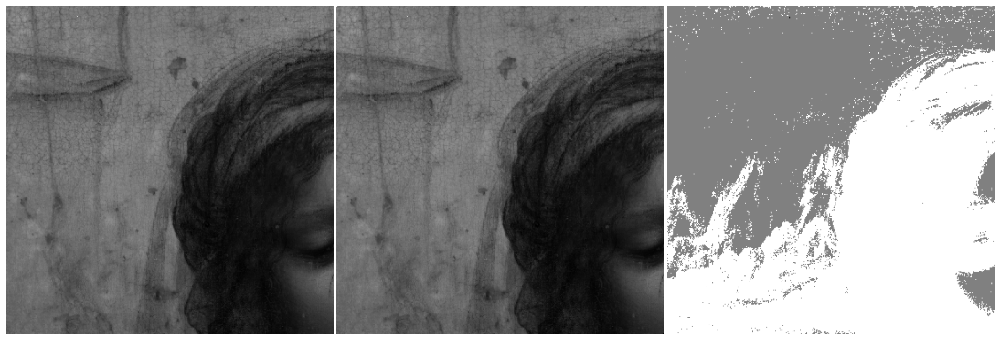

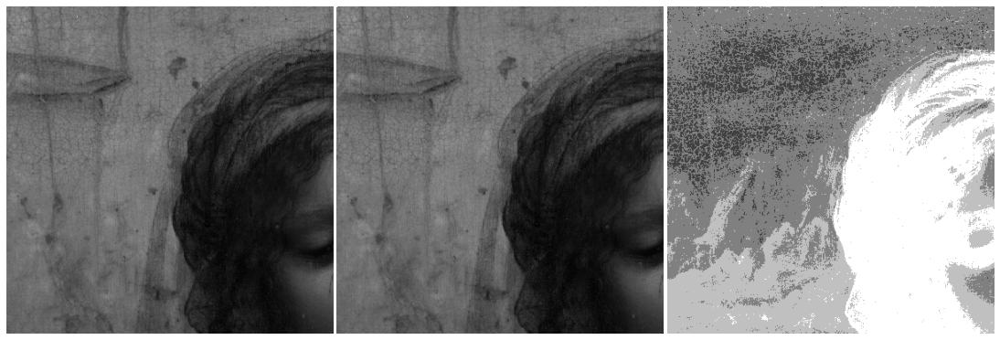

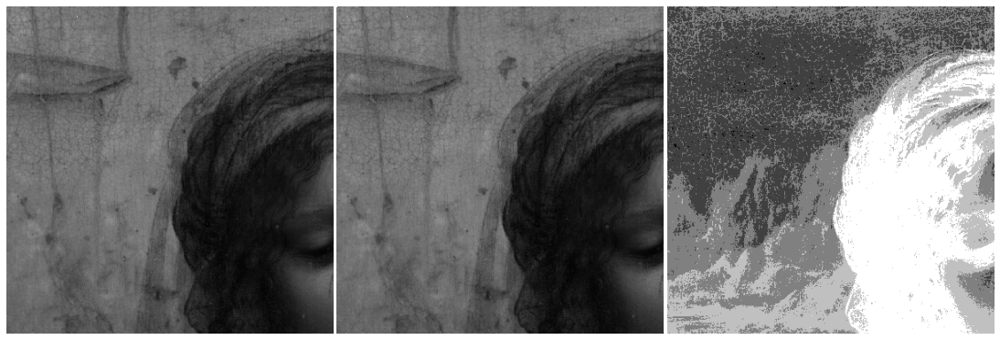

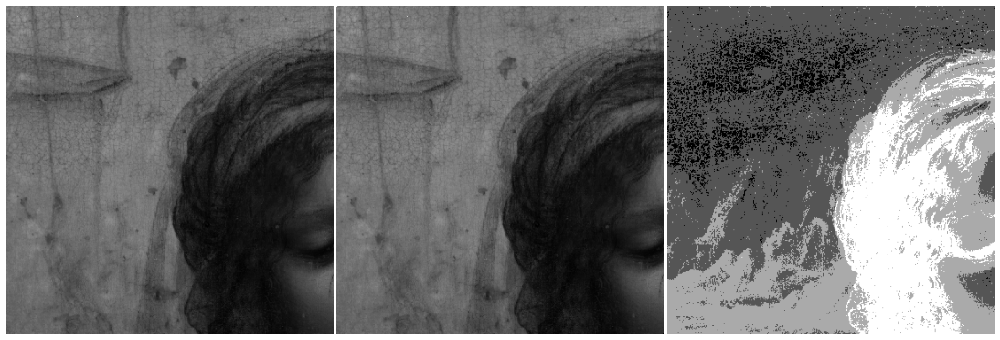

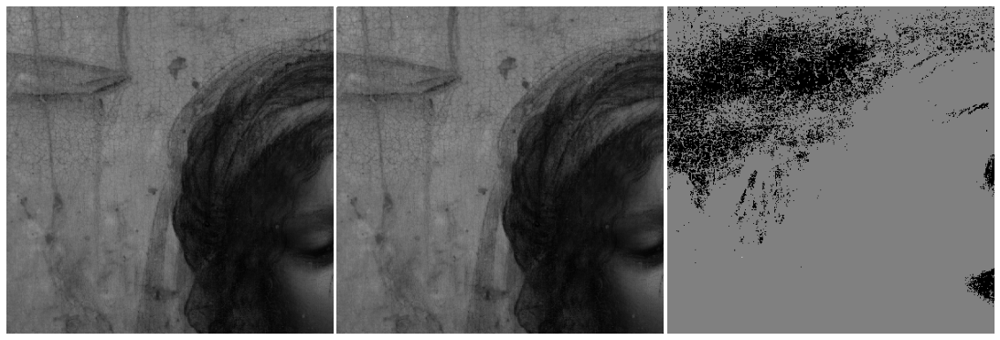

...

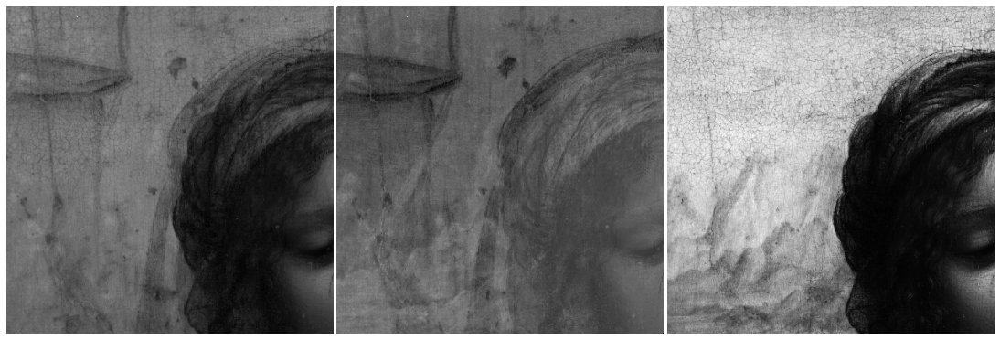

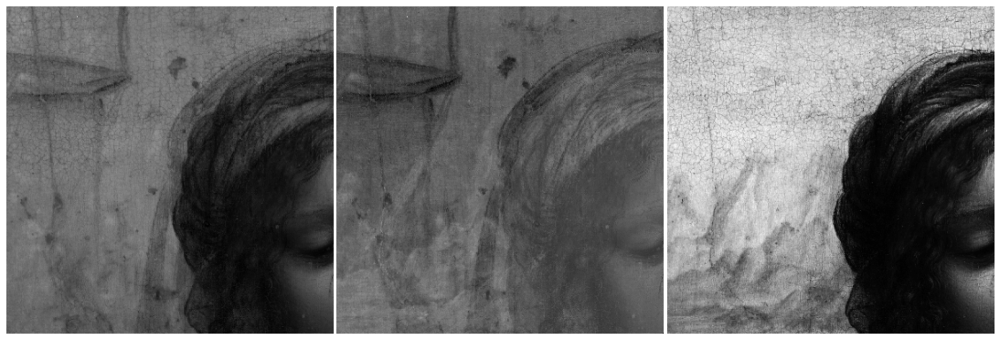

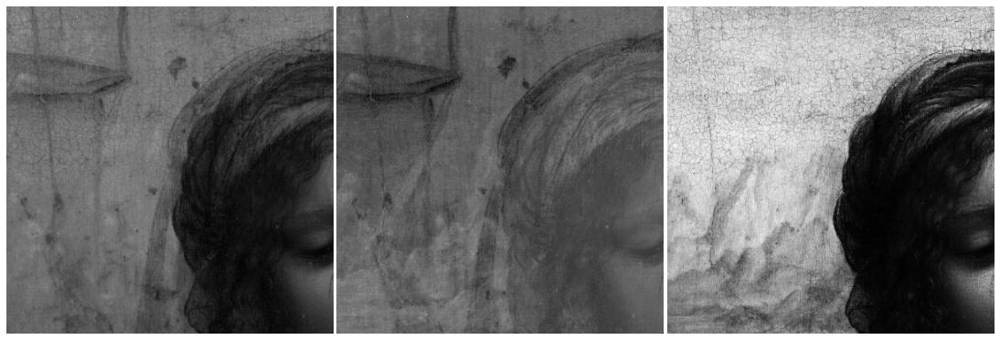

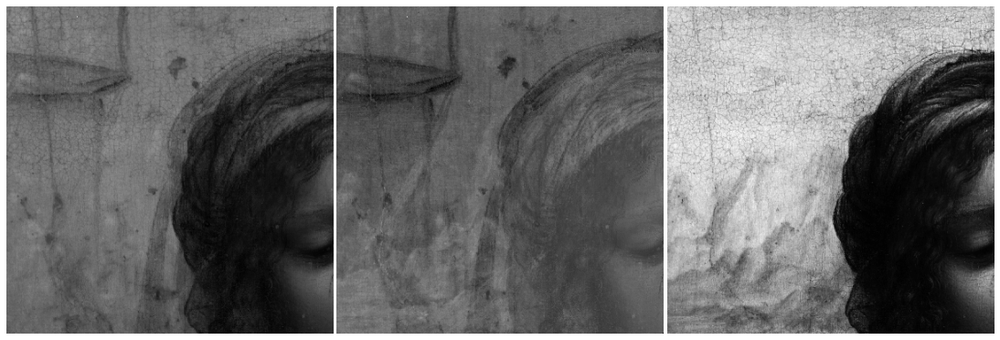

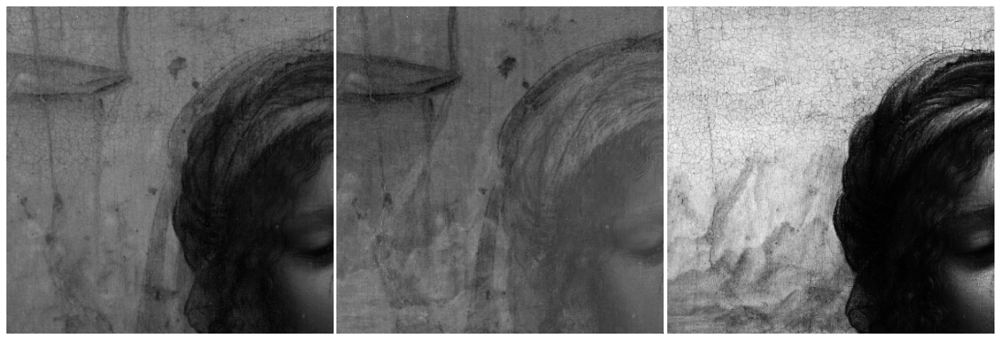

In [106]:
for i in range(56):
    prediction = imageio.imread(f"/Users/gimli/projects/igre/data/ig-animations/1612780091.407331/{i}.png")
    image = data[:400,:400,20] * 255 - prediction
    image[0,0] = np.max(image)
    image[-1,-1] = np.min(image)
    
    plt.figure(figsize=(15,5),frameon=False)
    
    ax = plt.subplot(1,3,1)
    ax.axis("off")
    ax.imshow(data[:400,:400,20], cmap="gray")
    
    ax = plt.subplot(1,3,2)
    ax.imshow(image, cmap="gray")
    ax.axis("off")
    
    ax = plt.subplot(1,3,3)
    ax.imshow(prediction, cmap="gray")
    ax.axis("off")
    
    plt.subplots_adjust(left=1, right=2, bottom=1, top=2, wspace=0.01, hspace=0)
    plt.savefig(f"/Users/gimli/projects/igre/data/ig-animations/1612780091.407331/full_{i}.png", 
                bbox_inches='tight',
                pad_inches=0)
    plt.show()

In [109]:
filenames = [f"/Users/gimli/projects/igre/data/ig-animations/1612780091.407331/full_{i}.png" for i in range(56)]
with imageio.get_writer('/Users/gimli/projects/igre/data/ig-animations/1612780091.407331/movie.gif', 
                        duration=0.5,
                        loop=1,
                        mode='I') as writer:
    for filename in filenames:
        image = imageio.imread(filename)
        writer.append_data(image)

In [110]:
rgb = imageio.imread("/Users/gimli/Pictures/2014-leonardo/FUSA(02).srgb.8bit.tif")

In [113]:
imageio.imwrite("/Users/gimli/ownCloud/information_gain_animace/rgb.png", rgb[250:650, 250:650, :])